In [33]:
using Plots; gr();
using DelimitedFiles
using HDF5
include("../src/cracks.jl")
include("../src/config.jl")

"igncn1.mat"

In [2]:
samples = readdlm("../data/remote/latlong_nobin/bsr_ignmajors_1.csv", ','); 
seismic = h5read("../data/remote/latlong_nobin/perplex_out_1.h5", "results"); # property, layer, sample

In [3]:
seismic[2:4,1,1]

3-element Array{Float64,1}:
 2676.628750009236   
    5.175148806729392
    2.165829041546647

In [4]:
plot(seriestype=:scatter, seismic[2,1,:], seismic[3,1,:], seismic[4,1,:], 
    marker_z=samples[:,findfirst(isequal("SiO2"), PERPLEX_ELEMENTS)], markersize=1, markerstrokewidth=0, 
    legend=false, colorbar=true)

In [5]:
crack_props = [random_cracking() for i in 1:size(samples,1)]; 
cracked_seismic = fill(NaN, size(seismic))
cracked_seismic[1,:,:] = seismic[1,:,:] # fill sample indices
for i in 1:size(seismic,3)
    if i%10000 == 0
        print("$i...")
    end
    for layer in 1:3
        if isnan(sum(seismic[2:4,layer,i]))
            continue
        end
        try
            cracked_seismic[2:4,layer,i] = [apply_cracking(seismic[2:4,layer,i]..., crack_props[i])...]
        catch e
            println("i=$i, layer=$layer")
            println(crack_props[i])
            println(seismic[:,layer,i])
            throw(e)
        end
    end
end

10000...20000...30000...40000...50000...60000...70000...80000...90000...100000...

In [6]:
i=1011
layer=1
cracked_seismic[2:4,layer,i] = [apply_cracking(seismic[2:4,layer,i]..., crack_props[i])...]

3-element Array{Float64,1}:
 2802.200992868477    
    5.132976628096434 
    1.9064240665106968

In [7]:
cameras = ((30,30), (30,80), (80,10))
plots = []
subset = rand(1:size(samples,1), 10000)
for camera in cameras
    push!(plots, plot(seriestype=:scatter, cracked_seismic[2,3,subset], cracked_seismic[3,3,subset], cracked_seismic[4,3,subset], 
        marker_z=samples[subset,findfirst(isequal("SiO2"), PERPLEX_ELEMENTS)], markersize=1, markerstrokewidth=0, 
        legend=false, colorbar=true, camera=camera, xlabel="Rho (kg/m^3)", ylabel="Vp (m/s)", zlabel="Vp/Vs"))
end 
plot(plots..., layout=(3,1), size=(600, 400*3))
    

In [8]:
cameras = ((30,30), (30,80), (80,10))
plots = []
subset = rand(1:size(samples,1), 10000)
for camera in cameras
    push!(plots, plot(seriestype=:scatter, cracked_seismic[2,1,subset], cracked_seismic[3,1,subset], cracked_seismic[4,1,subset], 
        marker_z=[c.porosity for c in crack_props[subset]], markersize=1, markerstrokewidth=0, 
        legend=false, colorbar=true, camera=camera, xlabel="Rho (kg/m^3)", ylabel="Vp (m/s)", zlabel="Vp/Vs"))
end 
plot(plots..., layout=(3,1), size=(600, 400*3), title="POROSITY")

In [9]:
cameras = ((30,30), (30,80), (80,10))
plots = []
subset = rand(1:size(samples,1), 10000)
for camera in cameras
    push!(plots, plot(seriestype=:scatter, cracked_seismic[2,1,subset], cracked_seismic[3,1,subset], cracked_seismic[4,1,subset], 
        marker_z=[findfirst(isequal(c.shape), ["needle", "sphere", "crack"]) for c in crack_props[subset]], 
        markersize=1, markerstrokewidth=0, 
        legend=false, colorbar=true, camera=camera, xlabel="Rho (kg/m^3)", ylabel="Vp (m/s)", zlabel="Vp/Vs"))
end 
plot(plots..., layout=(3,1), size=(600, 400*3))

In [10]:
cameras = ((30,30), (30,80), (80,10))
plots = []
subset = rand(1:size(samples,1), 10000)
for camera in cameras
    push!(plots, plot(seriestype=:scatter, cracked_seismic[2,1,subset], cracked_seismic[3,1,subset], cracked_seismic[4,1,subset], 
        marker_z=[findfirst(isequal(c.liquid), ["d", "w", "m"]) for c in crack_props[subset]], 
        markersize=1, markerstrokewidth=0, 
        legend=false, colorbar=true, camera=camera, xlabel="Rho (kg/m^3)", ylabel="Vp (m/s)", zlabel="Vp/Vs"))
end 
plot(plots..., layout=(3,1), size=(600, 400*3))

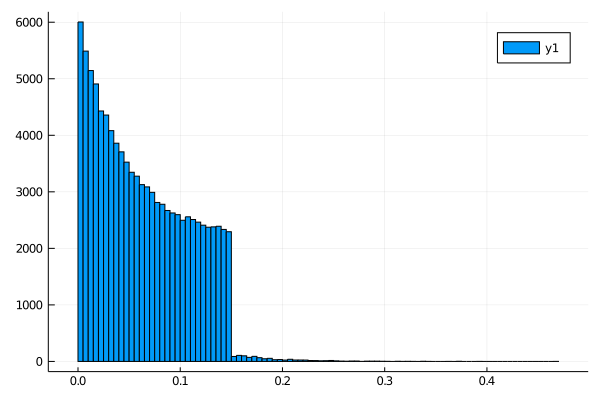

In [11]:
histogram([p.porosity for p in crack_props])

In [12]:
MAX_CRACK_POROSITY

0.041887902047863905

In [14]:
typeof(seismic)

Array{Float64,3}

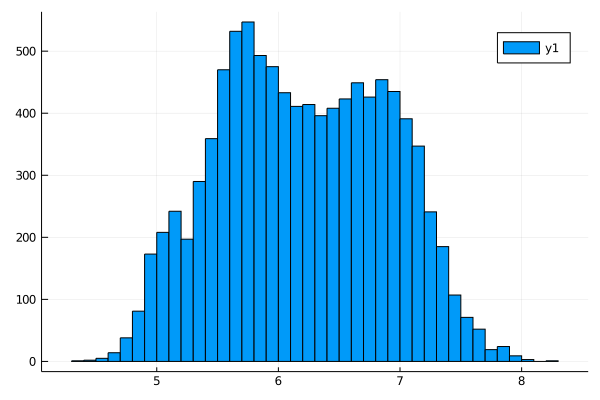

In [17]:
histogram(seismic[3,1,subset])

In [20]:
profiles = apply_cracking!(seismic)

100000-element Array{CrackProfile,1}:
 CrackProfile(cracked_properties, 1192.498489136683, 2.737118411032897, 0.14406441448584986, "w", "crack")  
 CrackProfile(cracked_properties, 0, 0, 0.030786382042584527, "d", "crack")                                 
 CrackProfile(sphere_properties, 0, 0, 0.128865624780697, "d", "sphere")                                    
 CrackProfile(needle_properties, 2300.098922242225, 70.82250816452033, 0.09402281687896909, "m", "needle")  
 CrackProfile(sphere_properties, 0, 0, 0.0032557491897266975, "d", "sphere")                                
 CrackProfile(needle_properties, 2440.175818046489, 70.15487253270061, 0.01971161018595763, "m", "needle")  
 CrackProfile(cracked_properties, 2325.338286054705, 19.10522620816217, 0.11112691805645683, "m", "crack")  
 CrackProfile(sphere_properties, 0, 0, 0.12074679039511088, "d", "sphere")                                  
 CrackProfile(sphere_properties, 1005.2788368243763, 3.168173180614504, 0.1404825995331713

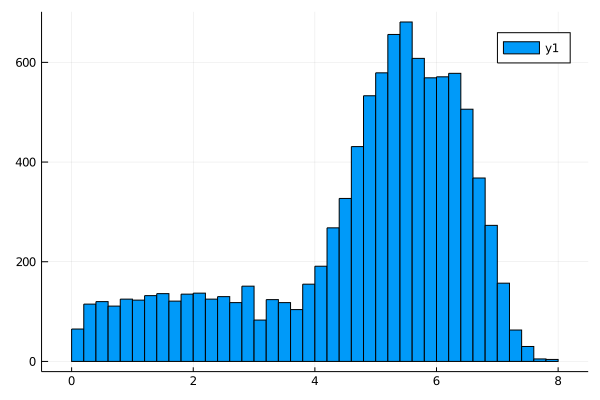

In [21]:
histogram(seismic[3,1,subset])